<a href="https://colab.research.google.com/github/t108368505/database_homework/blob/master/03_PyKaldi.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Automatic Speech Recognition Hand-on & Advanced Kaldi Toolkit Courses
by Yuan-Fu Liao, National Taipei University of Technology
* yfliao@ntut.edu.tw
---

# Introduction to PyKaldi
* Pykaldi: A Python wrapper for Kaldi https://pykaldi.github.io

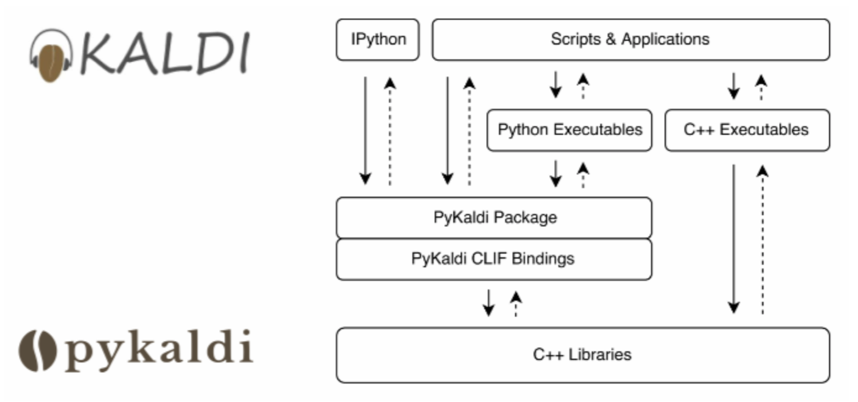

# Virtual Machine

## Hardware and Software

In [0]:
!lsb_release -a

No LSB modules are available.
Distributor ID:	Ubuntu
Description:	Ubuntu 18.04.3 LTS
Release:	18.04
Codename:	bionic


In [0]:
import sys ; print(sys.version_info)
!which python

sys.version_info(major=3, minor=6, micro=9, releaselevel='final', serial=0)
/usr/local/bin/python


In [0]:
!python --version
from distutils.sysconfig import get_python_lib
print(get_python_lib())

Python 3.6.9
/usr/lib/python3/dist-packages


In [0]:
import sys
sys.path

['',
 '/env/python',
 '/usr/lib/python36.zip',
 '/usr/lib/python3.6',
 '/usr/lib/python3.6/lib-dynload',
 '/usr/local/lib/python3.6/dist-packages',
 '/usr/local/lib/python3.6/dist-packages/pykaldi-0.1.2-py3.6-linux-x86_64.egg',
 '/usr/lib/python3/dist-packages',
 '/usr/local/lib/python3.6/dist-packages/IPython/extensions',
 '/root/.ipython',
 '/usr/local/lib/python3.6/dist-packages/pykaldi-0.1.2-py3.6-linux-x86_64.egg/kaldi/lat',
 '/usr/local/lib/python3.6/dist-packages/pykaldi-0.1.2-py3.6-linux-x86_64.egg/kaldi/cudamatrix',
 '/usr/local/lib/python3.6/dist-packages/pykaldi-0.1.2-py3.6-linux-x86_64.egg/kaldi/util',
 '/usr/local/lib/python3.6/dist-packages/pykaldi-0.1.2-py3.6-linux-x86_64.egg/kaldi/rnnlm',
 '/usr/local/lib/python3.6/dist-packages/pykaldi-0.1.2-py3.6-linux-x86_64.egg/kaldi/lib',
 '/usr/local/lib/python3.6/dist-packages/pykaldi-0.1.2-py3.6-linux-x86_64.egg/kaldi/hmm',
 '/usr/local/lib/python3.6/dist-packages/pykaldi-0.1.2-py3.6-linux-x86_64.egg/kaldi/__pycache__',
 '/usr/l

In [0]:
!ln -s /usr/local/lib/python3.6/dist-packages /usr/local/lib/python3.6/site-packages

In [0]:
import sys
sys.path.append('/usr/local/lib/python3.6/site-packages')
sys.path

['',
 '/env/python',
 '/usr/lib/python36.zip',
 '/usr/lib/python3.6',
 '/usr/lib/python3.6/lib-dynload',
 '/usr/local/lib/python3.6/dist-packages',
 '/usr/lib/python3/dist-packages',
 '/usr/local/lib/python3.6/dist-packages/IPython/extensions',
 '/root/.ipython',
 '/usr/local/lib/python3.6/site-packages']

In [0]:
!lscpu

Architecture:        x86_64
CPU op-mode(s):      32-bit, 64-bit
Byte Order:          Little Endian
CPU(s):              2
On-line CPU(s) list: 0,1
Thread(s) per core:  2
Core(s) per socket:  1
Socket(s):           1
NUMA node(s):        1
Vendor ID:           GenuineIntel
CPU family:          6
Model:               63
Model name:          Intel(R) Xeon(R) CPU @ 2.30GHz
Stepping:            0
CPU MHz:             2300.000
BogoMIPS:            4600.00
Hypervisor vendor:   KVM
Virtualization type: full
L1d cache:           32K
L1i cache:           32K
L2 cache:            256K
L3 cache:            46080K
NUMA node0 CPU(s):   0,1
Flags:               fpu vme de pse tsc msr pae mce cx8 apic sep mtrr pge mca cmov pat pse36 clflush mmx fxsr sse sse2 ss ht syscall nx pdpe1gb rdtscp lm constant_tsc rep_good nopl xtopology nonstop_tsc cpuid tsc_known_freq pni pclmulqdq ssse3 fma cx16 pcid sse4_1 sse4_2 x2apic movbe popcnt aes xsave avx f16c rdrand hypervisor lahf_lm abm invpcid_single ssbd ibrs 

In [0]:
!cat /proc/cpuinfo | grep 'core id'

core id		: 0
core id		: 0


In [0]:
!nvidia-smi

Mon Dec  9 09:49:52 2019       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 440.33.01    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|===============================+======================+======================|
|   0  Tesla K80           Off  | 00000000:00:04.0 Off |                    0 |
| N/A   47C    P8    31W / 149W |      0MiB / 11441MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
                                                                               
+-----------------------------------------------------------------------------+
| Processes:                                                       GPU Memory |
|  GPU  

In [0]:
!df

Filesystem     1K-blocks     Used Available Use% Mounted on
overlay        375674948 32091936 324430116  10% /
tmpfs              65536        0     65536   0% /dev
tmpfs            6667592        0   6667592   0% /sys/fs/cgroup
tmpfs            6667592       12   6667580   1% /var/colab
/dev/sda1      382718764 37747096 344955284  10% /opt/bin
shm              6160384        4   6160380   1% /dev/shm
tmpfs            6667592        0   6667592   0% /proc/acpi
tmpfs            6667592        0   6667592   0% /proc/scsi
tmpfs            6667592        0   6667592   0% /sys/firmware


## Requirements
* 因為連接時間到（12小時）後會被清掉，每次重開後都要重建工作環境

In [0]:
!sudo apt update
!sudo apt-get install autoconf automake cmake curl g++ git graphviz libatlas3-base libtool make pkg-config subversion unzip wget zlib1g-dev
!sudo apt install libasound-dev portaudio19-dev libportaudio2 libportaudiocpp0 ffmpeg
!sudo apt install python-pyaudio

Hit:1 http://archive.ubuntu.com/ubuntu bionic InRelease
Get:2 http://archive.ubuntu.com/ubuntu bionic-updates InRelease [88.7 kB]
Get:3 http://archive.ubuntu.com/ubuntu bionic-backports InRelease [74.6 kB]
Get:4 http://security.ubuntu.com/ubuntu bionic-security InRelease [88.7 kB]
Get:5 http://ppa.launchpad.net/graphics-drivers/ppa/ubuntu bionic InRelease [21.3 kB]
Get:6 http://ppa.launchpad.net/marutter/c2d4u3.5/ubuntu bionic InRelease [15.4 kB]
Get:7 https://cloud.r-project.org/bin/linux/ubuntu bionic-cran35/ InRelease [3,626 B]
Ign:8 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  InRelease
Get:9 http://archive.ubuntu.com/ubuntu bionic-updates/restricted amd64 Packages [32.7 kB]
Get:10 http://archive.ubuntu.com/ubuntu bionic-updates/universe amd64 Packages [1,322 kB]
Ign:11 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  InRelease
Hit:12 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  Rel

In [0]:
!pip install --upgrade pip
!pip install --upgrade setuptools
!pip install numpy pyparsing
!pip install ninja  # not required but strongly recommended

Requirement already up-to-date: pip in /usr/local/lib/python3.6/dist-packages (19.3.1)
Requirement already up-to-date: setuptools in /usr/local/lib/python3.6/dist-packages (42.0.2)


In [0]:
!sudo apt install ocaml-nox
!sudo apt install z3

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following packages were automatically installed and are no longer required:
  cuda-cufft-10-1 cuda-cufft-dev-10-1 cuda-curand-10-1 cuda-curand-dev-10-1
  cuda-cusolver-10-1 cuda-cusolver-dev-10-1 cuda-cusparse-10-1
  cuda-cusparse-dev-10-1 cuda-license-10-2 cuda-npp-10-1 cuda-npp-dev-10-1
  cuda-nsight-10-1 cuda-nsight-compute-10-1 cuda-nsight-systems-10-1
  cuda-nvgraph-10-1 cuda-nvgraph-dev-10-1 cuda-nvjpeg-10-1
  cuda-nvjpeg-dev-10-1 cuda-nvrtc-10-1 cuda-nvrtc-dev-10-1 cuda-nvvp-10-1
  libcublas10 libnvidia-common-430 nsight-compute-2019.5.0
  nsight-systems-2019.5.2
Use 'sudo apt autoremove' to remove them.
The following additional packages will be installed:
  camlp4 ledit libcamlp4-ocaml-dev libfindlib-ocaml libfindlib-ocaml-dev
  ocaml-base-nox ocaml-compiler-libs ocaml-findlib ocaml-interp
Suggested packages:
  ocaml-doc tuareg-mode | ocaml-mode
The following NEW packages will be

In [0]:
!sudo apt install sox

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following packages were automatically installed and are no longer required:
  cuda-cufft-10-1 cuda-cufft-dev-10-1 cuda-curand-10-1 cuda-curand-dev-10-1
  cuda-cusolver-10-1 cuda-cusolver-dev-10-1 cuda-cusparse-10-1
  cuda-cusparse-dev-10-1 cuda-license-10-2 cuda-npp-10-1 cuda-npp-dev-10-1
  cuda-nsight-10-1 cuda-nsight-compute-10-1 cuda-nsight-systems-10-1
  cuda-nvgraph-10-1 cuda-nvgraph-dev-10-1 cuda-nvjpeg-10-1
  cuda-nvjpeg-dev-10-1 cuda-nvrtc-10-1 cuda-nvrtc-dev-10-1 cuda-nvvp-10-1
  libcublas10 libnvidia-common-430 nsight-compute-2019.5.0
  nsight-systems-2019.5.2
Use 'sudo apt autoremove' to remove them.
The following additional packages will be installed:
  libopencore-amrnb0 libopencore-amrwb0 libsox-fmt-alsa libsox-fmt-base
  libsox3
Suggested packages:
  libsox-fmt-all
The following NEW packages will be installed:
  libopencore-amrnb0 libopencore-amrwb0 libsox-fmt-alsa libsox-

# Google Drive
* 連接網路硬碟以交換資料

In [0]:
from google.colab import drive
drive.mount('/content/drive/')
!ln -s "/content/drive/My Drive" "/content/mydrive"
!ln -s "/content/drive/My Drive/Colab Notebooks/" "/content/mycolab"

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive/


# PyKaldi Installation
* 編譯 PyKaldi 工具包

## Download

*請選擇要* (1)由source檔重新安裝，還是(2)下載已編譯好的程式包。選一種就可以。但請注意兩種方式都要從Tools繼續往下安裝！

**1**.   由source檔重新安裝！要編譯很久......

In [0]:
!git clone https://github.com/pykaldi/pykaldi.git

In [0]:
import os
os.chdir('/content/pykaldi')

In [0]:
!git clone -b pykaldi https://github.com/pykaldi/clif
!git clone -b pykaldi https://github.com/pykaldi/kaldi

2.   下載已編譯好之程式包: pykaldi.tar.gz。注意，被註解掉的是抓備份檔，不要執行！

In [0]:
!wget --load-cookies /tmp/cookies.txt "https://docs.google.com/uc?export=download&confirm=$(wget --quiet --save-cookies /tmp/cookies.txt --keep-session-cookies --no-check-certificate 'https://docs.google.com/uc?export=download&id=1LVFR-Ii2qWsQPVMjQWuAr1HoBZlN11PV' -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')&id=1LVFR-Ii2qWsQPVMjQWuAr1HoBZlN11PV" -O /content/pykaldi.tar.gz && rm -rf /tmp/cookies.txt

--2019-12-09 10:13:34--  https://docs.google.com/uc?export=download&confirm=ZL7e&id=1LVFR-Ii2qWsQPVMjQWuAr1HoBZlN11PV
Resolving docs.google.com (docs.google.com)... 172.253.120.101, 172.253.120.138, 172.253.120.113, ...
Connecting to docs.google.com (docs.google.com)|172.253.120.101|:443... connected.
HTTP request sent, awaiting response... 302 Moved Temporarily
Location: https://doc-0k-9o-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/qn9l6sjtfb54q89uj4ds0678sn2no25u/1575885600000/14057721822585437213/*/1LVFR-Ii2qWsQPVMjQWuAr1HoBZlN11PV?e=download [following]
--2019-12-09 10:13:34--  https://doc-0k-9o-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/qn9l6sjtfb54q89uj4ds0678sn2no25u/1575885600000/14057721822585437213/*/1LVFR-Ii2qWsQPVMjQWuAr1HoBZlN11PV?e=download
Resolving doc-0k-9o-docs.googleusercontent.com (doc-0k-9o-docs.googleusercontent.com)... 108.177.15.132, 2a00:1450:400c:c0c::84
Connecting to doc-0k-9o-docs.googleusercontent

In [0]:
!tar vxf /content/pykaldi.tar.gz

pykaldi/
pykaldi/tools/
pykaldi/tools/kaldi/
pykaldi/tools/kaldi/tools/
pykaldi/tools/kaldi/tools/sph2pipe_v2.5/
pykaldi/tools/kaldi/tools/sph2pipe_v2.5/sph_convert.h
pykaldi/tools/kaldi/tools/sph2pipe_v2.5/test/
pykaldi/tools/kaldi/tools/sph2pipe_v2.5/test/123_1pcle_shn.sph
pykaldi/tools/kaldi/tools/sph2pipe_v2.5/test/std1.hdr
pykaldi/tools/kaldi/tools/sph2pipe_v2.5/test/123_2pcbe_shn.sph
pykaldi/tools/kaldi/tools/sph2pipe_v2.5/test/big1.hdr
pykaldi/tools/kaldi/tools/sph2pipe_v2.5/test/test_all.pl
pykaldi/tools/kaldi/tools/sph2pipe_v2.5/test/123_2ulaw_shn.sph
pykaldi/tools/kaldi/tools/sph2pipe_v2.5/test/123_1ulaw_shn.sph
pykaldi/tools/kaldi/tools/sph2pipe_v2.5/test/123_1pcbe_shn.sph
pykaldi/tools/kaldi/tools/sph2pipe_v2.5/test/outfile-md5.list.macosx
pykaldi/tools/kaldi/tools/sph2pipe_v2.5/test/big2.hdr
pykaldi/tools/kaldi/tools/sph2pipe_v2.5/test/std2.hdr
pykaldi/tools/kaldi/tools/sph2pipe_v2.5/test/123_2alaw.sph
pykaldi/tools/kaldi/tools/sph2pipe_v2.5/test/123_2pcle_shn.sph
pykaldi/

In [0]:
#!wget --load-cookies /tmp/cookies.txt "https://docs.google.com/uc?export=download&confirm=$(wget --quiet --save-cookies /tmp/cookies.txt --keep-session-cookies --no-check-certificate 'https://docs.google.com/uc?export=download&id=1wXfSEPVcdhCBja0CQpkCoeh1ECiw_1TW' -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')&id=1wXfSEPVcdhCBja0CQpkCoeh1ECiw_1TW" -O /content/mypykaldi.tar.gz && rm -rf /tmp/cookies.txt

In [0]:
#!tar vxf /content/mypykaldi.tar.gz

##  Tools
* Pykaldi 用到的工具程式。因為連接時間到（12小時）後會被清掉，每次重開後都要重建工作環境

In [0]:
import os
os.chdir('/content/pykaldi/tools')
!pwd

/content/pykaldi/tools


In [0]:
!./check_dependencies.sh  # checks if system dependencies are installed

./check_dependencies.sh: all OK.


In [0]:
!./install_protobuf.sh    # installs both the C++ library and the Python package

Protobuf found in PATH.
Checking Protobuf version...
Protobuf version: 3.5.0
Protobuf version is compatible.
Checking Protobuf Python package...
Protobuf Python package version: 3.10.0
Protobuf Python package version is compatible.
Done installing Protobuf.


In [0]:
!python --version
!which python

Python 3.6.9
/usr/local/bin/python


In [0]:
#!./install_clif.sh /usr/bin/python3 /usr/lib/x86_64-linux-gnu/libpython3.6m.so.1       # installs both the C++ library and the Python package
!./install_clif.sh python3 /usr/lib/x86_64-linux-gnu/libpython3.6m.so.1       # installs both the C++ library and the Python package

Python 3.6.9
Destination /content/pykaldi/tools/clif already exists.
Already up to date.
/usr/local/bin/ninja
Using ninja for the clif backend build.
Checked out revision 307315.
Checked out revision 307315.
CMake Deprecation Warning at CMakeLists.txt:15 (cmake_policy):
  The OLD behavior for policy CMP0051 will be removed from a future version
  of CMake.

  The cmake-policies(7) manual explains that the OLD behaviors of all
  policies are deprecated and that a policy should be set to OLD only under
  specific short-term circumstances.  Projects should be ported to the NEW
  behavior and not rely on setting a policy to OLD.


-- Native target architecture is X86
-- Threads enabled.
-- Doxygen disabled.
-- Go bindings disabled.
-- OCaml bindings disabled, need ctypes >=0.4.
-- LLVM host triple: x86_64-unknown-linux-gnu
-- LLVM default target triple: x86_64-unknown-linux-gnu
-- Building with -fPIC
-- Constructing LLVMBuild project information
-- Targeting X86
-- Could NOT find Z3 (missi

In [0]:
# 若你是選『（2）下載已編譯好的程式包』，這部分已經事先編譯好，可以跳過。注意，若重新編譯需要數小時時間！
!./install_kaldi.sh       # installs the Kaldi toolkit

## Installation
* 建立 python package。這邊也是每次重開後都要重裝pykaldi套件到python工作環境中

In [0]:
#
# 以下註解掉的請先跳過，好像是colab notebook配置有改。
#

# 避免setup.py自動選擇python2。強迫使用python3，因為colab環境是使用python3
#!sudo mv /usr/local/bin/python /usr/local/bin/python.xx
#!sudo mv /usr/bin/python /usr/bin/python.xx
#!which python

In [0]:
# 不要清掉之前的設置，因為重新編譯要很久！
#!rm -rf /content/pykaldi/build/

In [0]:
!python --version
!which python
from distutils.sysconfig import get_python_lib
print(get_python_lib())

Python 3.6.9
/usr/local/bin/python
/usr/lib/python3/dist-packages


In [0]:
import sys
sys.path

['',
 '/env/python',
 '/usr/lib/python36.zip',
 '/usr/lib/python3.6',
 '/usr/lib/python3.6/lib-dynload',
 '/usr/local/lib/python3.6/dist-packages',
 '/usr/lib/python3/dist-packages',
 '/usr/local/lib/python3.6/dist-packages/IPython/extensions',
 '/root/.ipython',
 '/usr/local/lib/python3.6/site-packages']

In [0]:
import os
os.chdir('/content/pykaldi')
!which python
!python setup.py install

/usr/local/bin/python
running install
running bdist_egg
running egg_info
writing pykaldi.egg-info/PKG-INFO
writing dependency_links to pykaldi.egg-info/dependency_links.txt
writing requirements to pykaldi.egg-info/requires.txt
writing top-level names to pykaldi.egg-info/top_level.txt
writing manifest file 'pykaldi.egg-info/SOURCES.txt'
installing library code to build/bdist.linux-x86_64/egg
running install_lib
running build_py
running build_ext
-- Found PythonInterp: /usr/bin/python3.6 (found version "3.6.9") 
-- Found PythonLibs: /usr/lib/x86_64-linux-gnu/libpython3.6m.so (found version "3.6.9") 
Using PYCLIF: /usr/local/bin/pyclif
Using CLIF_MATCHER: /usr/clang/bin/clif-matcher
-- Configuring done
-- Generating done
-- Build files have been written to: /content/pykaldi/build
[742/742] Linking CXX shared library lib/kaldi/nnet3/_nnet_chain_example_merger.so

creating build/bdist.linux-x86_64/egg
creating build/bdist.linux-x86_64/egg/kaldi
creating build/bdist.linux-x86_64/egg/kaldi/la

In [0]:
# 注意！請restart runtime: "Tool --> restart runtime"，讓notebook的 python可以認得新安裝的套件！

#
# 以下註解掉的請先跳過，好像是colab notebook配置有改。
#
# 復原python環境。因為之前為避免setup.py自動選擇python2，強迫其使用python3。
#!sudo cp /usr/local/bin/python.xx /usr/local/bin/python
#!sudo cp /usr/bin/python.xx /usr/bin/python

In [0]:
# 測試apykaldi是否正確安裝。測試都有PASSED，就沒問題，可以開始使用！
!which python
!python setup.py test

/usr/local/bin/python
running pytest
running egg_info
writing pykaldi.egg-info/PKG-INFO
writing dependency_links to pykaldi.egg-info/dependency_links.txt
writing requirements to pykaldi.egg-info/requires.txt
writing top-level names to pykaldi.egg-info/top_level.txt
writing manifest file 'pykaldi.egg-info/SOURCES.txt'
running build_ext
Using PYCLIF: /usr/local/bin/pyclif
Using CLIF_MATCHER: /usr/clang/bin/clif-matcher
-- Configuring done
-- Generating done
-- Build files have been written to: /content/pykaldi/build
ninja: no work to do.

copying build/lib/kaldi/lat/_determinize_lattice_pruned.so -> kaldi/lat
copying build/lib/kaldi/lat/_minimize_lattice.so -> kaldi/lat
copying build/lib/kaldi/lat/_word_align_lattice_lexicon.so -> kaldi/lat
copying build/lib/kaldi/lat/_lattice_functions.so -> kaldi/lat
copying build/lib/kaldi/lat/_compose_lattice_pruned.so -> kaldi/lat
copying build/lib/kaldi/lat/_push_lattice.so -> kaldi/lat
copying build/lib/kaldi/lat/_word_align_lattice.so -> kaldi/la

In [0]:
!pip list | grep kaldi

pykaldi                  0.1.2      


# Experimental Working Environment

## Microphone

In [0]:
AUDIO_HTML = """
<script>
var my_div = document.createElement("DIV");
var my_p = document.createElement("P");
var my_btn = document.createElement("BUTTON");
var t = document.createTextNode("Press to start recording");

my_btn.appendChild(t);
//my_p.appendChild(my_btn);
my_div.appendChild(my_btn);
document.body.appendChild(my_div);

var base64data = 0;
var reader;
var recorder, gumStream;
var recordButton = my_btn;

var handleSuccess = function(stream) {
  gumStream = stream;
  var options = {
    //bitsPerSecond: 8000, //chrome seems to ignore, always 48k
    mimeType : 'audio/webm;codecs=opus'
    //mimeType : 'audio/webm;codecs=pcm'
  };            
  //recorder = new MediaRecorder(stream, options);
  recorder = new MediaRecorder(stream);
  recorder.ondataavailable = function(e) {            
    var url = URL.createObjectURL(e.data);
    var preview = document.createElement('audio');
    preview.controls = true;
    preview.src = url;
    document.body.appendChild(preview);

    reader = new FileReader();
    reader.readAsDataURL(e.data); 
    reader.onloadend = function() {
      base64data = reader.result;
      //console.log("Inside FileReader:" + base64data);
    }
  };
  recorder.start();
  };

recordButton.innerText = "Recording... press to stop";

navigator.mediaDevices.getUserMedia({audio: true}).then(handleSuccess);

function toggleRecording() {
  if (recorder && recorder.state == "recording") {
      recorder.stop();
      gumStream.getAudioTracks()[0].stop();
      recordButton.innerText = "Saving the recording... pls wait!"
  }
}

// https://stackoverflow.com/a/951057
function sleep(ms) {
  return new Promise(resolve => setTimeout(resolve, ms));
}

var data = new Promise(resolve=>{
//recordButton.addEventListener("click", toggleRecording);
recordButton.onclick = ()=>{
toggleRecording()

sleep(2000).then(() => {
  // wait 2000ms for the data to be available...
  // ideally this should use something like await...
  //console.log("Inside data:" + base64data)
  resolve(base64data.toString())

});

}
});
      
</script>
"""

## Python Packages

In [0]:
!pip install pyaudio
!pip install ffmpeg-python
!pip install librosa
!pip install pydub
!pip install praat-parselmouth
!pip install sklearn

  Created wheel for pyaudio: filename=PyAudio-0.2.11-cp36-cp36m-linux_x86_64.whl size=51620 sha256=9e2e79d44bae99177b40b19fe3147548081940d50f1f72acdd79892ea7eafe30
  Stored in directory: /root/.cache/pip/wheels/f4/a8/a4/292214166c2917890f85b2f72a8e5f13e1ffa527c4200dcede
Successfully built pyaudio
     |████████████████████████████████| 9.0MB 24kB/s 


In [0]:
import os # to save/open files 
import sys
import io
from IPython.display import HTML, Audio
from google.colab.output import eval_js
from base64 import b64decode
import numpy as np
import ffmpeg
import wave
import pydub
from pydub import AudioSegment
from scipy.io.wavfile import read as wav_read
import matplotlib.pyplot as plt
import librosa
import librosa.display
from six.moves.urllib.parse import quote
import parselmouth
from sklearn import preprocessing

## Function Calls

In [0]:
def write_wav(f, sr, x, normalized=False):
    # 開檔
    f = wave.open(f, "wb")

    # 配置聲道数、量化位数和取樣频率
    f.setnchannels(1)
    f.setsampwidth(2)
    f.setframerate(sr)

    # 轉換為二進制，再寫入檔案
    wave_data = x.astype(np.short)
    f.writeframes(wave_data.tostring())
    f.close()

In [0]:
def get_audio(human_sound_file):
		global hnum

		# call microphone
		display(HTML(AUDIO_HTML))
		data = eval_js("data")
		binary = b64decode(data.split(',')[1])
  
		process = (ffmpeg
	  		.input('pipe:0')
	  		.output('pipe:1', format='wav')
	  		.run_async(pipe_stdin=True, pipe_stdout=True, pipe_stderr=True, quiet=True, overwrite_output=True)
		)
		output, err = process.communicate(input=binary)
  
		riff_chunk_size = len(output) - 8
		# Break up the chunk size into four bytes, held in b.
		q = riff_chunk_size
		b = []
		for i in range(4):
				q, r = divmod(q, 256)
				b.append(r)

		# Replace bytes 4:8 in proc.stdout with the actual size of the RIFF chunk.
		riff = output[:4] + bytes(b) + output[8:]
		sr, audio = wav_read(io.BytesIO(riff))

		# save
		print(human_sound_file)
		write_wav(human_sound_file, sr, audio)

		return human_sound_file

In [0]:
def write_wav(f, sr, x, normalized=False):
    # 開檔
    f = wave.open(f, "wb")

    # 配置聲道数、量化位数和取樣频率
    f.setnchannels(1)
    f.setsampwidth(2)
    f.setframerate(sr)

    # 轉換為二進制，再寫入檔案
    wave_data = x.astype(np.short)
    f.writeframes(wave_data.tostring())
    f.close()

In [0]:
def get_audio(human_sound_file):
		global hnum

		# call microphone
		display(HTML(AUDIO_HTML))
		data = eval_js("data")
		binary = b64decode(data.split(',')[1])
  
		process = (ffmpeg
	  		.input('pipe:0')
	  		.output('pipe:1', format='wav')
	  		.run_async(pipe_stdin=True, pipe_stdout=True, pipe_stderr=True, quiet=True, overwrite_output=True)
		)
		output, err = process.communicate(input=binary)
  
		riff_chunk_size = len(output) - 8
		# Break up the chunk size into four bytes, held in b.
		q = riff_chunk_size
		b = []
		for i in range(4):
				q, r = divmod(q, 256)
				b.append(r)

		# Replace bytes 4:8 in proc.stdout with the actual size of the RIFF chunk.
		riff = output[:4] + bytes(b) + output[8:]
		sr, audio = wav_read(io.BytesIO(riff))


		# save
		print(human_sound_file)
		write_wav(human_sound_file, sr, audio)

		return human_sound_file

# Feature Extraction

In [0]:
import os
os.chdir('/content/')

## Loading Speech file
* 以下的音檔，請選一個

In [0]:
!cp /content/pykaldi/examples/setups/aspire/data/LibriSpeech-dev-clean-2/1272-135031-0000.flac.wav /content/utt0.wav
!sox utt0.wav -r 16000 -c 1 -b 16 -e signed-integer utt1.wav
Audio('utt1.wav', autoplay=False)

In [0]:
!cp /content/pykaldi/examples/setups/NER-Trs-Vol1/data/test/BW_20171229_006.wav /content/utt0.wav
!sox utt0.wav -r 16000 -c 1 -b 16 -e signed-integer utt1.wav
Audio('utt1.wav', autoplay=False)

In [0]:
# Human Speak
human_sound_file = 'utt0.wav'
get_audio(human_sound_file)
!sox utt0.wav -r 16000 -c 1 -b 16 -e signed-integer utt1.wav
human_sound_file = 'utt1.wav'

## FBanks, MFCCs and Pitch

>>> print(wav.sample_freq)
16000.0

>>> print(s)

    -6    -11     -7  ...    -106   -132   -129
[kaldi.matrix._matrix.Matrix of size 1x174160]


>>> print(pitch_f)

 1.2088 -1.9233 -0.0776  1.0188
 1.1471 -1.9218  0.0053  1.0188
 0.9713 -1.9215  0.4675  1.0188
               ⋮                
 1.2410  0.1252 -0.0542 -1.3765
 1.1157  0.1176  0.1475 -1.3765
 1.2416  0.1128 -0.1625 -1.3765
[kaldi.matrix._matrix.SubMatrix of size 1087x4]


>>> print(spec_f)

-1.9452e+00 -1.2645e+00 -1.1622e+00  ...  -6.5824e-01 -4.9879e-01 -2.8988e-01
-1.9198e+00 -9.1485e-01 -1.0063e+00  ...  -8.2932e-01 -7.6966e-01 -5.5204e-01
-1.7452e+00 -2.6794e-01 -8.9106e-01  ...  -6.9529e-01 -8.2036e-01 -7.3685e-01
                ...                   ⋱                   ...                
-1.7125e+00 -1.8334e+00 -1.9730e+00  ...  -1.2799e+00 -1.4380e+00 -1.1961e+00
-1.6625e+00 -5.7703e-01 -1.1257e+00  ...  -1.1728e+00 -1.5178e+00 -1.0832e+00
-1.5652e+00 -3.0983e-01 -7.6542e-01  ...  -2.4435e+00 -1.8772e+00 -1.15

<function matplotlib.pyplot.tight_layout>

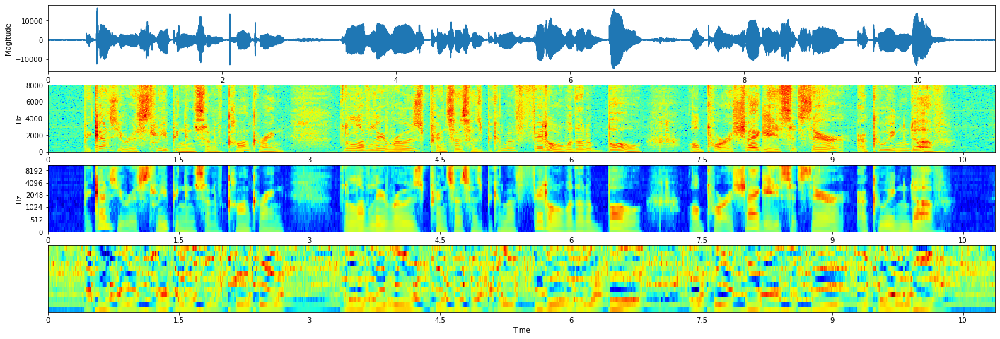

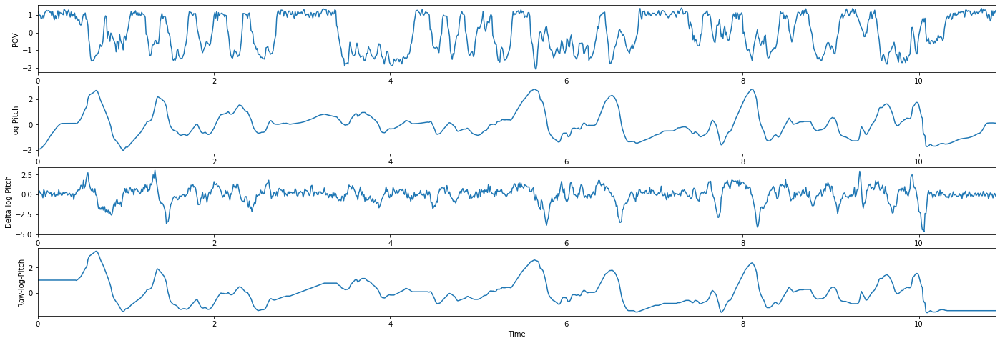

In [0]:
import matplotlib.pyplot as plt
import librosa
import librosa.display
import numpy as np

from kaldi.feat.window import FeatureWindowFunction, FrameExtractionOptions
from kaldi.feat.spectrogram import Spectrogram, SpectrogramOptions
from kaldi.feat.mfcc import Mfcc, MfccOptions
from kaldi.feat.fbank import Fbank, FbankOptions
from kaldi.feat.mel import MelBanks, MelBanksOptions
from kaldi.feat.pitch import PitchExtractionOptions, ProcessPitchOptions
from kaldi.feat.pitch import *

from kaldi.matrix import SubVector, SubMatrix
from kaldi.util.options import ParseOptions
from kaldi.util.table import SequentialWaveReader
from kaldi.util.table import MatrixWriter
from numpy import mean
from sklearn.preprocessing import scale

with open("testfile.scp", "w") as outpt:
    outpt.write("TEST utt1.wav")

spec_opts = SpectrogramOptions()
mfcc_opts = MfccOptions()
mfcc_opts.frame_opts.samp_freq = 16000
fbank_opts = FbankOptions()
pitch_opts = PitchExtractionOptions()
pitch_opts.samp_freq=16000.0
pitch_process_opts=ProcessPitchOptions()
pitch_process_opts.add_raw_log_pitch=True

rspec, fbank_wspec, mfcc_wspec, pitch_wspec, spec_wspec = \
        "scp:testfile.scp", "ark,t:test_fbank.ark", \
        "ark,t:test_mfcc.ark", "ark,t:test_pitch.ark", \
        "ark,t:test_spec.ark"

# class, no pitch class, only pitch function calls
spec = Spectrogram(spec_opts)
mfcc = Mfcc(mfcc_opts)
fbank = Fbank(fbank_opts)
sf = mfcc_opts.frame_opts.samp_freq

with SequentialWaveReader(rspec) as reader, \
        MatrixWriter(fbank_wspec) as fbank_writer, \
        MatrixWriter(mfcc_wspec) as mfcc_writer, \
        MatrixWriter(pitch_wspec) as pitch_writer, \
        MatrixWriter(spec_wspec) as spec_writer:
            
    for key, wav in reader:
                    
        assert(wav.samp_freq >= sf)
        assert(wav.samp_freq % sf == 0)

        print(">>> print(wav.sample_freq)")
        print(wav.samp_freq)
        print()
        
        s = wav.data()
        print(">>> print(s)")
        print(s)
        print()

        # mix-down stereo to mono
        m = SubVector(mean(s, axis=0))

        # compute pitch features
        pitch_f = compute_kaldi_pitch(pitch_opts,m)
        pitch_f = process_pitch(pitch_process_opts,pitch_f)
        # standardize features
        pitch_f = SubMatrix(scale(pitch_f))
        print(">>> print(pitch_f)")
        print(pitch_f)
        print()
        # write features to archive
        pitch_writer[key] = pitch_f

        # compute Spectrogram features
        spec_f = spec.compute_features(m, sample_freq=sf, vtln_warp=1.0)
        # standardize features
        spec_f = SubMatrix(scale(spec_f))
        print(">>> print(spec_f)")
        print(spec_f)
        print()
        # write features to archive
        spec_writer[key] = spec_f

        # compute FBANK features
        fbank_f = fbank.compute_features(m, sample_freq=sf, vtln_warp=1.0)
        # standardize features
        fbank_f = SubMatrix(scale(fbank_f))
        print(">>> print(fbank_f)")
        print(fbank_f)
        print()
        # write features to archive
        fbank_writer[key] = fbank_f

        # compute MFCC features
        mfcc_f = mfcc.compute_features(m, sample_freq=sf, vtln_warp=1.0)
        # standardize features
        mfcc_f = SubMatrix(scale(mfcc_f))
        print(">>> print(mfcc_f)")
        print(mfcc_f)
        print()
        # write features to archive
        mfcc_writer[key] = mfcc_f

audio = s.numpy().transpose()
pitch_feature = pitch_f.numpy()
fbank_feature = fbank_f.numpy().transpose()
mfcc_feature = mfcc_f.numpy().transpose()
spec_feature = spec_f.numpy().transpose()

# plot
plt.figure(figsize=(24, 8))

# waveform
plt.subplot(4,1,1)
x = np.linspace(0,len(audio)/sf,len(audio))
print(x.shape, audio.shape)
plt.plot(x,audio)
plt.xlabel('Time')
plt.ylabel('Magitude')
plt.xlim(x.min(), x.max())

plt.subplot(4,1,2)
librosa.display.specshow(spec_feature, sr=16000,  hop_length=160, x_axis='time', y_axis= 'linear', cmap='jet')

plt.subplot(4,1,3)
librosa.display.specshow(fbank_feature, sr=16000, hop_length=160, x_axis='time', y_axis='mel', cmap='jet')

plt.subplot(4,1,4)
librosa.display.specshow(mfcc_feature, sr=16000, hop_length=160, x_axis='time', y_axis='off', cmap='jet')

plt.tight_layout

# pitch features
plt.figure(figsize=(24, 8))
x = np.linspace(0,len(pitch_feature)/100,len(pitch_feature))

plt.subplot(4,1,1)
plt.xlabel('Time')
plt.ylabel('POV')
plt.plot(x, pitch_feature[:,0])
plt.xlim(x.min(), x.max())

plt.subplot(4,1,2)
plt.plot(x, pitch_feature[:,1])
plt.xlabel('Time')
plt.ylabel('log-Pitch')
plt.xlim(x.min(), x.max())

plt.subplot(4,1,3)
plt.plot(x, pitch_feature[:,2])
plt.xlabel('Time')
plt.ylabel('Delta-log-Pitch')
plt.xlim(x.min(), x.max())

plt.subplot(4,1,4)
plt.plot(x, pitch_feature[:,3])
plt.xlabel('Time')
plt.ylabel('Raw-log-Pitch')
plt.xlim(x.min(), x.max())

plt.tight_layout


## Praat vs. Kaldi
* 比較 Kali 跟 Praat 求出來的 pitch contour，kaldi比較平滑

In [0]:
def draw_spectrogram(spectrogram, dynamic_range=70):
    X, Y = spectrogram.x_grid(), spectrogram.y_grid()
    sg_db = 10 * np.log10(spectrogram.values)
    plt.pcolormesh(X, Y, sg_db, vmin=sg_db.max() - dynamic_range, cmap='gray')
    plt.ylim([spectrogram.ymin, spectrogram.ymax])
    plt.xlabel("time [s]")
    plt.ylabel("frequency [Hz]")

def draw_pitch(pitch):
    # Extract selected pitch contour, and
    # replace unvoiced samples by NaN to not plot
    pitch_values = pitch.selected_array['frequency']
    pitch_values[pitch_values==0] = np.nan
    plt.plot(pitch.xs(), pitch_values, 'o', markersize=8, color='w')
    plt.plot(pitch.xs(), pitch_values, 'o', markersize=4)
    plt.grid(False)
    plt.ylim(0, pitch.ceiling)
    plt.ylabel("fundamental frequency [Hz]")

<function matplotlib.pyplot.tight_layout>

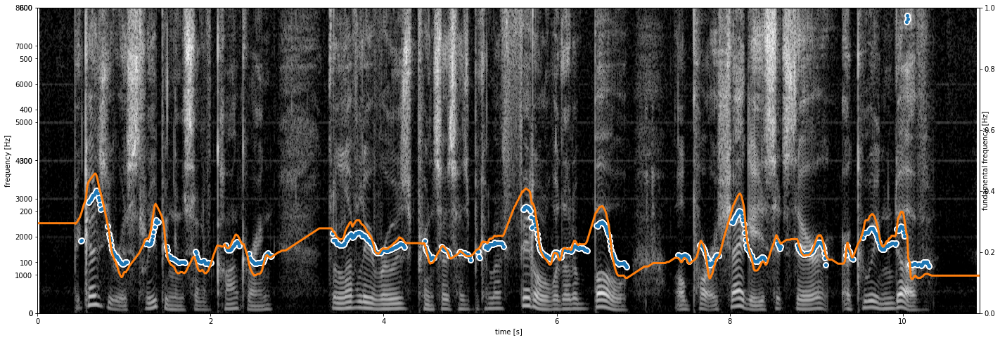

In [0]:
snd = parselmouth.Sound('utt1.wav')
snd.resample(new_frequency=16000)
pitch = snd.to_pitch()

# If desired, pre-emphasize the sound fragment before calculating the spectrogram
pre_emphasized_snd = snd.copy()
pre_emphasized_snd.pre_emphasize()
spectrogram = pre_emphasized_snd.to_spectrogram(window_length=0.03, maximum_frequency=8000)

plt.figure(figsize=(24, 8))
draw_spectrogram(spectrogram)
plt.twinx()
draw_pitch(pitch)
plt.xlim([snd.xmin, snd.xmax])

yp0 = pitch.selected_array['frequency']
yp0[yp0==0] = np.nan
yp0m = np.nanmean(yp0)
yp0d = np.nanstd(yp0)

yp = yp0m + yp0d*pitch_feature[:,3]
xs = np.linspace(snd.xmin, snd.xmax, len(yp))
plt.plot(xs, yp, linewidth=3)
plt.twinx()
plt.tight_layout

# English Speech Recognizer

## Introduction

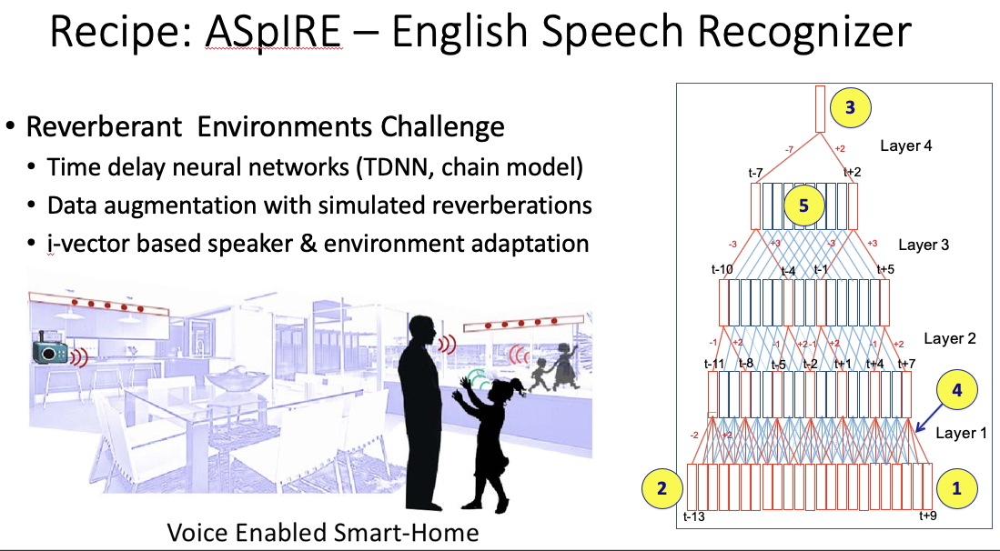

## Download Corpus
* LibriSpeech

In [0]:
# 若你是選『（2）下載已編譯好的程式包』，這部分已經事先打包進來了，可以跳過
import os
os.chdir('/content/pykaldi/examples/setups/aspire/data')

In [0]:
# 若你是選『（2）下載已編譯好的程式包』，這部分已經事先打包進來了，可以跳過
!wget --load-cookies /tmp/cookies.txt "https://docs.google.com/uc?export=download&confirm=$(wget --quiet --save-cookies /tmp/cookies.txt --keep-session-cookies --no-check-certificate 'https://docs.google.com/uc?export=download&id=1nRVwLS0jT1jMNBy-uhyZhEHJ5McmcOye' -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')&id=1nRVwLS0jT1jMNBy-uhyZhEHJ5McmcOye" -O /content/LibriSpeech-dev-clean-2.zip && rm -rf /tmp/cookies.txt

In [0]:
# 若你是選『（2）下載已編譯好的程式包』，這部分已經事先打包進來了，可以跳過
!unzip -o /content/LibriSpeech-dev-clean-2.zip

## Download Model
* Aspire

In [0]:
# 若你是選『（2）下載已編譯好的程式包』，這部分已經事先打包進來了，但要切換目錄！
import os
os.chdir('/content/pykaldi/examples/setups/aspire/')
!ls

align.py  data	     exp		      models.sh  path.sh    test
conf	  decode.py  LibriSpeech-dev-clean-2  out	 README.md


In [0]:
# 若你是選『（2）下載已編譯好的程式包』，這部分已經事先打包進來了，可以跳過
!./models.sh

## Decoding

In [0]:
# 列印測試音檔
!cat data/test/wav.scp

utt1			data/test/utt1.wav
1272-135031-0000	data/LibriSpeech-dev-clean-2/1272-135031-0000.flac.wav
1272-135031-0001	data/LibriSpeech-dev-clean-2/1272-135031-0001.flac.wav
1272-135031-0002	data/LibriSpeech-dev-clean-2/1272-135031-0002.flac.wav
1272-135031-0003	data/LibriSpeech-dev-clean-2/1272-135031-0003.flac.wav
1272-135031-0004	data/LibriSpeech-dev-clean-2/1272-135031-0004.flac.wav
1272-135031-0005	data/LibriSpeech-dev-clean-2/1272-135031-0005.flac.wav
1272-135031-0006	data/LibriSpeech-dev-clean-2/1272-135031-0006.flac.wav
1272-135031-0007	data/LibriSpeech-dev-clean-2/1272-135031-0007.flac.wav
1272-135031-0008	data/LibriSpeech-dev-clean-2/1272-135031-0008.flac.wav
1272-135031-0009	data/LibriSpeech-dev-clean-2/1272-135031-0009.flac.wav
1272-135031-0010	data/LibriSpeech-dev-clean-2/1272-135031-0010.flac.wav
1272-135031-0011	data/LibriSpeech-dev-clean-2/1272-135031-0011.flac.wav


In [0]:
# 開始辨認
!source path.sh && /usr/bin/python3 decode.py

LOG ([5.5.201~1420-7d4bd]:RemoveOrphanNodes():nnet-nnet.cc:948) Removed 1 orphan nodes.
LOG ([5.5.201~1420-7d4bd]:RemoveOrphanComponents():nnet-nnet.cc:847) Removing 2 orphan components.
LOG ([5.5.201~1420-7d4bd]:Collapse():nnet-utils.cc:1378) Added 1 components, removed 2
compute-mfcc-feats --config=conf/mfcc_hires.conf scp:data/test/wav.scp ark:- 
compute-mfcc-feats --config=conf/mfcc_hires.conf scp:data/test/wav.scp ark:- 
ivector-extract-online2 --config=conf/ivector_extractor.conf ark:data/test/spk2utt ark:- ark:- 
LOG (ivector-extract-online2[5.5.201~1420-7d4bd]:ComputeDerivedVars():ivector-extractor.cc:183) Computing derived variables for iVector extractor
LOG (ivector-extract-online2[5.5.201~1420-7d4bd]:ComputeDerivedVars():ivector-extractor.cc:204) Done.
LOG (compute-mfcc-feats[5.5.201~1420-7d4bd]:main():compute-mfcc-feats.cc:172) Processed 10 utterances
LOG (compute-mfcc-feats[5.5.201~1420-7d4bd]:main():compute-mfcc-feats.cc:176)  Done 13 out of 13 utterances.
LOG (compute-mf

## Recognition Results

In [0]:
# 列印辨認結果
!cat out/test/decode.out

utt1 [noise] [noise] one two three four five six seven eight
1272-135031-0000 because you were a sleeping incentive conquering the lovely rose princes has become a fiddle with other bowl oh poor shaggy sits there uh cooing duff
1272-135031-0001 he has gone gone for a good answered pauli chrome who would manage to squeeze into the room beside the dragon and had to witness the occurrences was much interest
1272-135031-0002 i have remained their prisoner only because i wished to be one and with this he stepped forward and <unk> change as easily as if they had been threads
1272-135031-0003 the little girl had been asleep but she heard the reps and open the door
1272-135031-0004 it's a king is clinton disgrace in your friends are asking for you
1272-135031-0005 i beg your <unk> long ago to send them away but he would do so
1272-135031-0006 i also offered to help your brother to escape but he would not go
1272-135031-0007 [noise] he eats and sleeps very steadily replayed the new kings
1272-1

In [0]:
Audio('data/LibriSpeech-dev-clean-2/1272-135031-0000.flac.wav', autoplay=True)

In [0]:
Audio('data/LibriSpeech-dev-clean-2/1272-135031-0001.flac.wav', autoplay=True)

# Mandarin Speech Recognizer

## Introduction

* National Education Radio Corpus


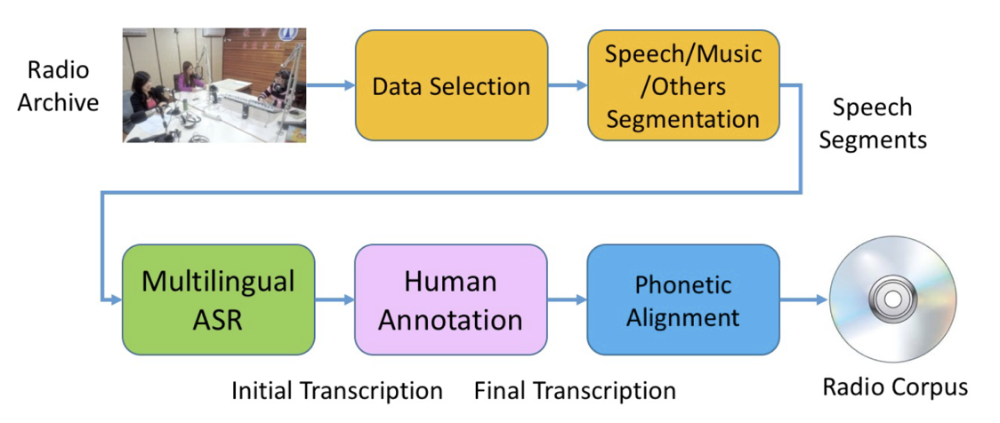

* Kaldi Nnet3/Chain Time-Delay Neural Network

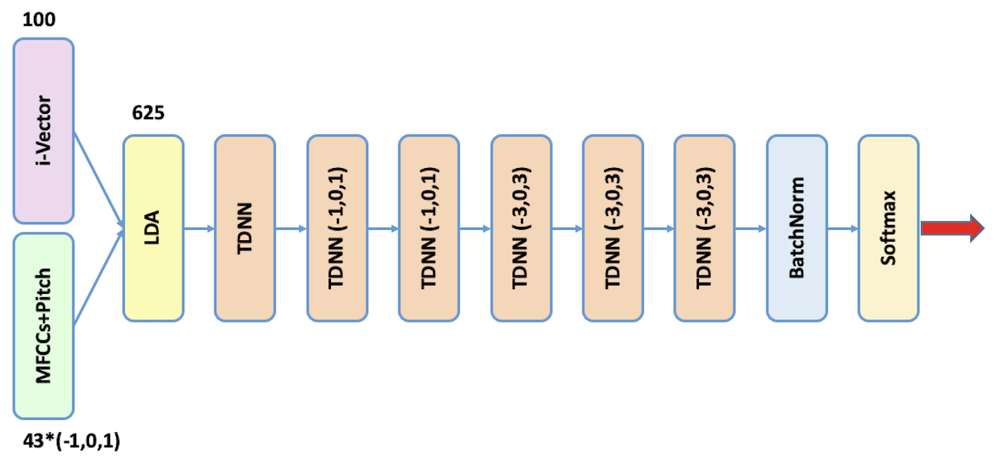

## Download Model

In [0]:
# 若你是選『（2）下載已編譯好的程式包』，這部分已經事先打包進來了，但要切換目錄！
import os
os.chdir('/content/pykaldi/examples/setups/')

In [0]:
# 若你是選『（2）下載已編譯好的程式包』，這部分已經事先打包進來了，可以跳過
!wget --load-cookies /tmp/cookies.txt "https://docs.google.com/uc?export=download&confirm=$(wget --quiet --save-cookies /tmp/cookies.txt --keep-session-cookies --no-check-certificate 'https://docs.google.com/uc?export=download&id=1tx79zbDMS9o1ZEhPA2VylKuFxdEj37a9' -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')&id=1tx79zbDMS9o1ZEhPA2VylKuFxdEj37a9" -O /content/NER-Trs-Vol1.zip && rm -rf /tmp/cookies.txt

In [0]:
# 若你是選『（2）下載已編譯好的程式包』，這部分已經事先打包進來了，可以跳過
!unzip -o /content/NER-Trs-Vol1.zip

## Recognition

In [0]:
import os
os.chdir('/content/pykaldi/examples/setups/NER-Trs-Vol1/')

In [0]:
# 列印測試音檔
!cat data/test/wav.scp

BW_20171229_006 data/test/BW_20171229_006.wav
BW_20171229_034 data/test/BW_20171229_034.wav
CX_20160114_011 data/test/CX_20160114_011.wav
CX_20160114_082 data/test/CX_20160114_082.wav
DW_20160401_014 data/test/DW_20160401_014.wav
DW_20160401_054 data/test/DW_20160401_054.wav
GX_20180321_009 data/test/GX_20180321_009.wav
GX_20180321_074 data/test/GX_20180321_074.wav
GX_20180328_009 data/test/GX_20180328_009.wav
GX_20180328_096 data/test/GX_20180328_096.wav
TA_1050402_026 data/test/TA_1050402_026.wav
TA_1050402_120 data/test/TA_1050402_120.wav


### Decoding: Batch Mode

In [0]:
!source path.sh && /usr/bin/python3 decode.py

LOG ([5.5.201~1420-7d4bd]:RemoveOrphanNodes():nnet-nnet.cc:948) Removed 9 orphan nodes.
LOG ([5.5.201~1420-7d4bd]:RemoveOrphanComponents():nnet-nnet.cc:847) Removing 19 orphan components.
LOG ([5.5.201~1420-7d4bd]:Collapse():nnet-utils.cc:1378) Added 10 components, removed 19
paste-feats 'ark:compute-mfcc-feats --config=conf/mfcc_hires.conf scp:data/test/wav.scp ark:- |' 'ark:compute-kaldi-pitch-feats --config=conf/pitch.conf scp:data/test/wav.scp ark:- | process-kaldi-pitch-feats ark:- ark:- |' ark:- 
compute-mfcc-feats --config=conf/mfcc_hires.conf scp:data/test/wav.scp ark:- 
compute-kaldi-pitch-feats --config=conf/pitch.conf scp:data/test/wav.scp ark:- 
process-kaldi-pitch-feats ark:- ark:- 
compute-mfcc-feats --config=conf/mfcc_hires.conf scp:data/test/wav.scp ark:- 
ivector-extract-online2 --config=conf/ivector_extractor.conf ark:data/test/spk2utt ark:- ark:- 
LOG (ivector-extract-online2[5.5.201~1420-7d4bd]:ComputeDerivedVars():ivector-extractor.cc:183) Computing derived variabl

In [0]:
!cat out/test/decode.out

BW_20171229_006 但是 在 一九六零年代 開始 呢 就 有人 提出來 綠色 設計 這樣 的 概念 設計 這樣 的 概念 呢 它 是 以 就是 為 的 就是 在 這樣 的 核心 概念 為 原則 那 在 從事 設計 的 時候 會 注重 到 幾 個 環節 就是 材料 的 選擇 還有 產品 的 高楠 結構 甘美 關心 還有 包裝 眼熟 產銷
BW_20171229_034 但是 因為 作者 本身 他 非常 喜歡 也 自可 本身 的 形狀 那 他用 的 這 個 材料 把 它 做 得 比較 巨大 然後 再 加上 一些 顏色 去 做 處理 經過 大戰 才 然後 有志於 跟 一 些 回收 的 材料 去 處理 而成 然後 呈現出 一種 全心 樣貌 等 就 說 家 我們 一般 強烈 材料 變成 一件 很 有 價值 的 藝術品
CX_20160114_011 好 吧 放出 了 還是 要 把 它 放 來 講 他 今天 忘了 抓 幾個 點閱 沒關係 我 還 想 跟 你 就 會 把 今天 的 故事 說 這 個 精彩 一點 好了 彌補 我 的 過失 今天 我們 要 講 的 故事 那 就是 生活 他 就是 修行
CX_20160114_082 然後 <SIL> <SIL> <SIL> <SIL> <SIL> <SIL> <SIL> <SIL> <SIL> <SIL> <SIL> <SIL>
DW_20160401_014 兩 千零八 年 開始 在 英國廣播公司 專欄 請問 馬拉 用 的 觀點 在 他 的 生活 同時 他 也 呼籲 剩 教育 的 權利
DW_20160401_054 當然 就是 世界 我 民國 不過 今非昔比 現在 印度 不是 超級 到底 有 多 高 那 我 告訴 你 全球 兩口 百分之三十
GX_20180321_009 就是 代表 我們 學校 的 一種 精神 也 做 了 我們 的 建築師 綠建築 沒有 圍牆 之外 我們 我們 的 校地 有 將近 五 點 三 工具 所以 裡面 很多 大叔 留 綠地 非常 有 特色 一 個 建築 的 調適 校內 有 四個 字 孔子 就是 校園 就是 下 大雨 之後 <SIL>
GX_20180321_074 做 呈現 出來 是 好像 我們 在 禮拜 的 那 個 香港 的 學校 的 這 兩 組 的 發表 的 就是 覺得 手足 不到 住不到

In [0]:
Audio('data/test/BW_20171229_006.wav', autoplay=True)

In [0]:
Audio('data/test/BW_20171229_034.wav', autoplay=True)

### Standalone Mode

In [0]:
!./standalone.sh

online2-wav-nnet3-latgen-faster --config=conf/online.conf --add-pitch=true --do-endpointing=false --frames-per-chunk=50 --extra-left-context-initial=0 --online=true --frame-subsampling-factor=3 --min-active=1000 --max-active=7000 --beam=15.0 --lattice-beam=8.0 --online=false --acoustic-scale=1.0 --word-symbol-table=model/words.txt model/final.mdl model/HCLG.fst ark:data/test/spk2utt scp:data/test/wav.scp ark,t:out/test/standalone-decode.txt 
LOG (online2-wav-nnet3-latgen-faster[5.5.201~1420-7d4bd]:ComputeDerivedVars():ivector-extractor.cc:183) Computing derived variables for iVector extractor
LOG (online2-wav-nnet3-latgen-faster[5.5.201~1420-7d4bd]:ComputeDerivedVars():ivector-extractor.cc:204) Done.
LOG (online2-wav-nnet3-latgen-faster[5.5.201~1420-7d4bd]:RemoveOrphanNodes():nnet-nnet.cc:948) Removed 9 orphan nodes.
LOG (online2-wav-nnet3-latgen-faster[5.5.201~1420-7d4bd]:RemoveOrphanComponents():nnet-nnet.cc:847) Removing 19 orphan components.
LOG (online2-wav-nnet3-latgen-faster[5.5

In [0]:
#!cat out/test/standalone-decode.txt

### Online Mode

In [0]:
# Human Speak
human_sound_file = 'data/test/utt0.wav'
get_audio(human_sound_file)
!sox data/test/utt0.wav -r 16000 -c 1 -b 16 -e signed-integer data/test/utt1.wav
human_sound_file = 'data/test/utt1.wav'

In [0]:
!source path.sh && /usr/bin/python3 decode-1.py

In [0]:
!cat out/test/decode-1.out

In [0]:
# utt1.wav
human_sound_file = 'data/test/utt1.wav'
Audio(human_sound_file, autoplay=True)

# Backup
* 你有更改，又有想要保存，才需要做！

In [0]:
import os
os.chdir('/content/')
!tar vcf mypykaldi.tar.gz pykaldi /usr/local/lib

pykaldi/
pykaldi/.gitignore
pykaldi/.travis.yml
pykaldi/setup.cfg
pykaldi/dist/
pykaldi/dist/pykaldi-0.1.2-py3.6-linux-x86_64.egg
pykaldi/CMakeLists.txt
pykaldi/docs/
pykaldi/docs/api.rst
pykaldi/docs/_static/
pykaldi/docs/_static/pykaldi-logo-bean.png
pykaldi/docs/_static/pykaldi-logo-light.png
pykaldi/docs/_static/pykaldi-logo-dark.png
pykaldi/docs/_static/pykaldi-architecture.png
pykaldi/docs/_static/pykaldi-theme.css
pykaldi/docs/_static/.keep
pykaldi/docs/CMakeLists.txt
pykaldi/docs/dev/
pykaldi/docs/dev/conv.rst
pykaldi/docs/dev/.keep
pykaldi/docs/pykaldi.pdf
pykaldi/docs/conf.py
pykaldi/docs/api/
pykaldi/docs/api/kaldi.transform.rst
pykaldi/docs/api/kaldi.kws.rst
pykaldi/docs/api/kaldi.tree.rst
pykaldi/docs/api/kaldi.segmentation.rst
pykaldi/docs/api/kaldi.hmm.rst
pykaldi/docs/api/kaldi.alignment.rst
pykaldi/docs/api/kaldi.fstext.rst
pykaldi/docs/api/kaldi.nnet3.rst
pykaldi/docs/api/kaldi.chain.rst
pykaldi/docs/api/kaldi.matrix.rst
pykaldi/docs/api/kaldi.util.rst
pykaldi/docs/ap

In [0]:
!cp /content/mypykaldi.tar.gz /content/mycolab/

In [0]:
!cp /content/mypykaldi.tar.gz /content/mydrive/OpenAIFunCup/03\ CoLab/